# Single Cell Analysis and Data processing for Deepcell segmentation

# Prerequisites

In [1]:
library(imcRtools)
library(dittoSeq)
library(tidyverse)
library(ggplot2)

Loading required package: SpatialExperiment

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, rowMads, 

In [2]:
set_base_dir_method <- "Relative"

In [3]:
if (set_base_dir_method == "Relative") {
    notebook_dir <- getwd()
    data_dir <- fs::path_dir(notebook_dir)
} else if (set_base_dir_method == "Manual") {
    data_dir = "/path/to/data/directory"
}

In [4]:
# set the base directory
base_dir = data_dir

In [22]:
results_dir = fs::path_join(c(base_dir, "analysis"))
results_graphs_dir = fs::path_join(c(base_dir, "analysis", "graphs"))
results_objects_dir = fs::path_join(c(base_dir, "analysis", "objects"))
cell_table_dir_qupath = fs::path_join(c(base_dir, "segmentation","cell_table_qupath"))
cell_table_dir_qc = fs::path_join(c(base_dir, "segmentation", "cell_table"))

In [23]:
for (directory in c(results_dir, results_graphs_dir, results_objects_dir)) {
    dir.create(directory,showWarnings = FALSE)
}

# Reading in Data from custom files


In [7]:

# Only using the normalized counts here
cur_features <- read_csv(fs::path_join(c(cell_table_dir_qc, "cell_table_size_normalized_GI_6717_3_region_001.csv")))

dim(cur_features)
colnames(cur_features)


markers_list = colnames(cur_features)[2:24]
print(markers_list)
print(length(markers_list))

counts <- cur_features[,markers_list]


meta <- cur_features[,c("fov", "label", "area",
                            "eccentricity")]
colnames(meta) <- c("fov", "ObjectNumber", "area",
                            "eccentricity")


coords <- cur_features[,c("centroid-1", "centroid-0")]
colnames(coords) <- c("adj_x", "adj_y")


Rows: 64702 Columns: 42
── Column specification ────────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr  (2): fov, mask_type
dbl (40): cell_size, ASMA, CCL19, CD11C, CD146, CD3, CD31, CD4, CD45, CD68, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 64702    42

[1] "cell_size"                   "ASMA"                       
 [3] "CCL19"                       "CD11C"                      
 [5] "CD146"                       "CD3"                        
 [7] "CD31"                        "CD4"                        
 [9] "CD45"                        "CD68"                       
[11] "CD8"                         "CD90"                       
[13] "CDH11"                       "DAPI_FINAL"                 
[15] "DAPI_INIT"                   "HLADR"                      
[17] "MERTK"                       "PANCADHERIN"                
[19] "PANCK"                       "PDGFRA"                     
[21] "PDPN"                        "PSTAT1"                     
[23] "SPARC"                       "VIM"                        
[25] "label"                       "area"                       
[27] "eccentricity"                "major_axis_length"          
[29] "minor_axis_length"           "perimeter"                  
[31] "convex_area"                 "equivalent_diameter"        
[33] "centroid-0"                  "centroid-1"                 
[35] "major_minor_axis_ratio"      "perim_square_over_area"     
[37] "major_axis_equiv_diam_ratio" "convex_hull_resid"          
[39] "centroid_dif"                "num_concavities"            
[41] "fov"                         "mask_type"

 [1] "ASMA"        "CCL19"       "CD11C"       "CD146"       "CD3"        
 [6] "CD31"        "CD4"         "CD45"        "CD68"        "CD8"        
[11] "CD90"        "CDH11"       "DAPI_FINAL"  "DAPI_INIT"   "HLADR"      
[16] "MERTK"       "PANCADHERIN" "PANCK"       "PDGFRA"      "PDPN"       
[21] "PSTAT1"      "SPARC"       "VIM"        
[1] 23


In [8]:
colnames(counts)[18] <- "CK8"
colnames(counts)

[1] "ASMA"        "CCL19"       "CD11C"       "CD146"       "CD3"        
 [6] "CD31"        "CD4"         "CD45"        "CD68"        "CD8"        
[11] "CD90"        "CDH11"       "DAPI_FINAL"  "DAPI_INIT"   "HLADR"      
[16] "MERTK"       "PANCADHERIN" "CK8"         "PDGFRA"      "PDPN"       
[21] "PSTAT1"      "SPARC"       "VIM"

In [9]:

spe <- SpatialExperiment(assays = list(counts = t(counts)),
                          colData = meta, 
                          sample_id = meta$fov,
                          spatialCoords = as.matrix(coords))



In [10]:
colnames(spe) <- paste0(spe$sample_id, "_", spe$ObjectNumber)

In [11]:

assay(spe, "exprs") <- asinh(counts(spe)/1) # untransformed "counts" are preserved and can be accessed as counts


In [15]:
saveRDS(spe, fs::path_join(c(results_dir, "spe_before_filtering.rds")))
# spe <- readRDS(here("spe_before_filtering.rds"))

# QC steps

## Segmented cell area QC

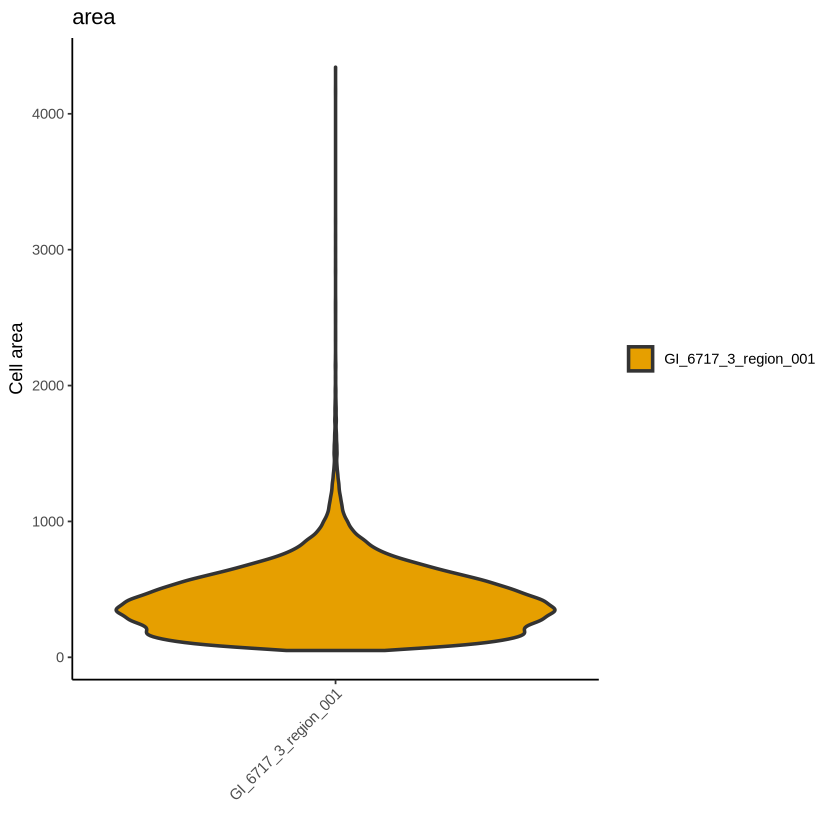

In [16]:
# Boxplot
dittoPlot(spe, var = "area", 
          group.by = "sample_id", 
          plots = "vlnplot") + 
  ylab("Cell area") + xlab("")

This can be modified depending on what is relevant to the dataset

In [ ]:
# spe <- spe[,spe$area >= 10] #this is because multiplexed imaging does not capture whole cells, but measures slices of cells. Small cellsare likely slices that are not representativ of the whole cell
# spe <- spe[,spe$area <= 3000] 
# I cut it down from 4000 to 2000

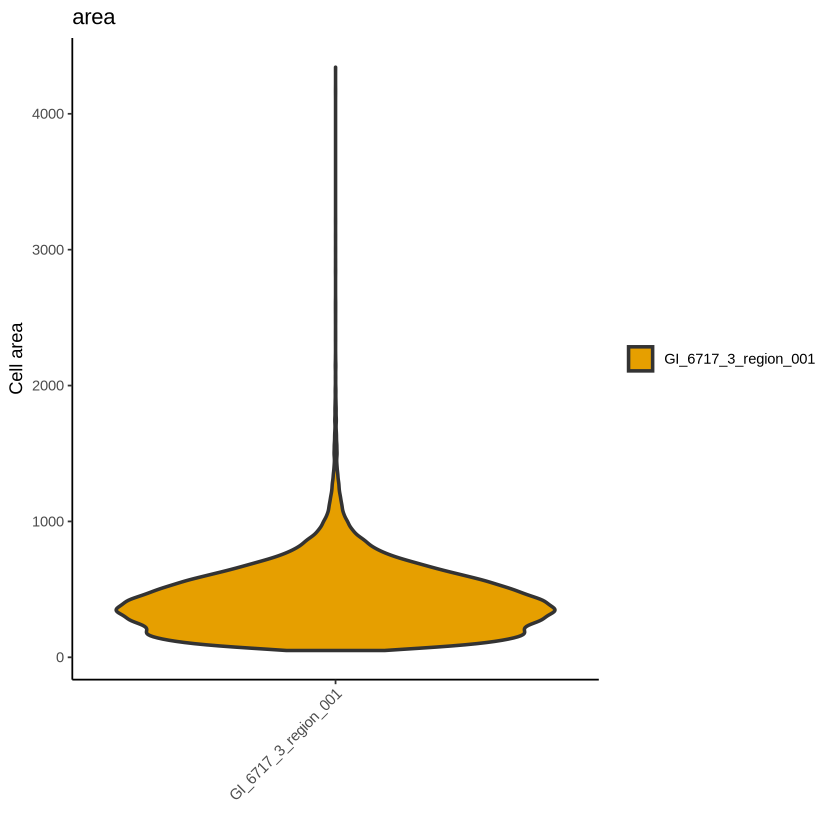

In [17]:
# Boxplot
dittoPlot(spe, var = "area", 
          group.by = "sample_id", 
          plots = "vlnplot") + 
  ylab("Cell area") + xlab("")

Saving 7 x 7 in image


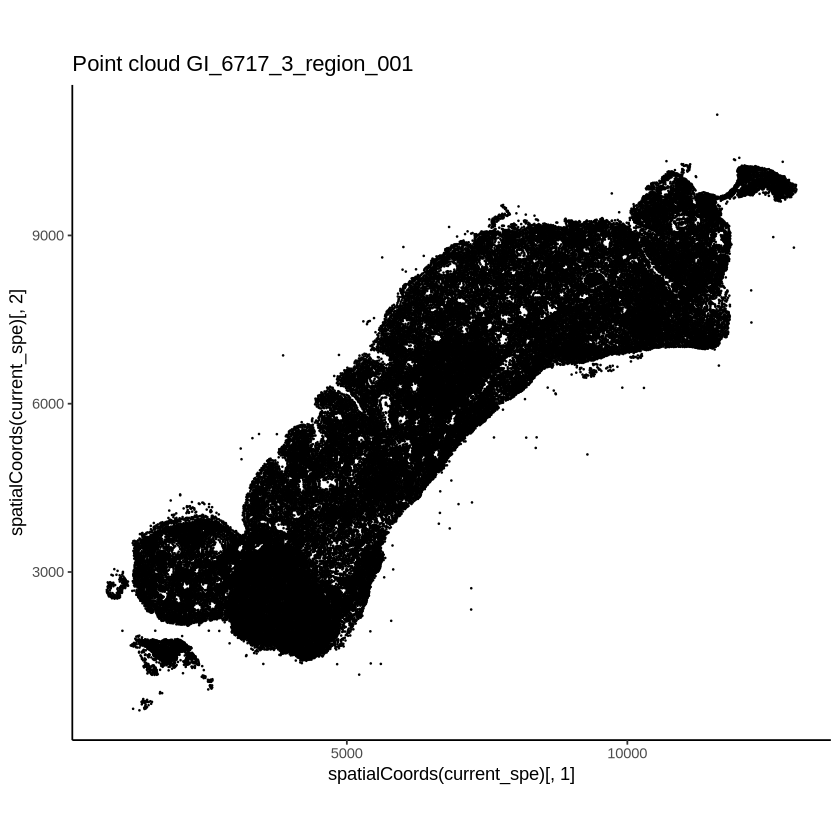

In [24]:
for (i in 1:length(unique(spe$sample_id))){
  current_patient_id <- unique(spe$sample_id)[i]
  current_spe <- spe[,spe$sample_id == current_patient_id]

  points_graph<- ggplot(colData(current_spe), aes(spatialCoords(current_spe)[,1], spatialCoords(current_spe)[,2])) + geom_point(size=0.1) + coord_fixed(ratio = 1) + theme_classic() + labs(title = paste0("Point cloud ", current_patient_id))
  print(points_graph)
  ggsave(filename = fs::path_join(c(results_graphs_dir, paste0("Points cloud_", current_patient_id, ".png"))), plot = points_graph,create.dir = TRUE)

}


In [25]:
saveRDS(spe, fs::path_join(c(results_objects_dir, "spe_DeepCell_old.rds")))
# spe <- readRDS(here("without_morpho","spe_post_filtering.rds"))